In [7]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [1]:
import numpy as np
import os
import pickle as p
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import networkx as nx
import sys
sys.path.extend(['/home/rohit/PhD_Work/GM_my_version/Graph_matching'])
import slam.io as sio
import networkx as nx
import tools.graph_visu as gv
import tools.graph_processing as gp
import matplotlib.pyplot as plt
import random
import plotly.express as px
import plotly.figure_factory as ff

In [2]:
#generate random color codes for plotting
def generate_random_color_codes(num_colors):
    
    number_of_colors = num_colors
    
    color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(number_of_colors)]
    
    return color

In [3]:
path_1 = "/home/rohit/PhD_Work/GM_my_version/Graph_matching/data/OASIS_full_batch/modified_graphs/"

In [4]:
graphs = os.listdir(path_1)
G = p.load(open(path_1 + graphs[0], "rb" ))

In [5]:
def remove_dummy_nodes(graph):
    G = graph.copy()
    to_remove = []
    for (p, d) in G.nodes(data=True):
        if d['is_dummy'] == True:
            to_remove.append(p)
    G.remove_nodes_from(to_remove)
    return G

In [6]:
new_G = remove_dummy_nodes(G)

In [13]:
new_G.remove_edges_from(nx.selfloop_edges(new_G))

In [12]:
# d = nx.degree(new_G)
# d = dict(d)

# nx.draw(new_G, nodelist=d.keys(), node_size=[v * 20 for v in d.values()])
# plt.show()

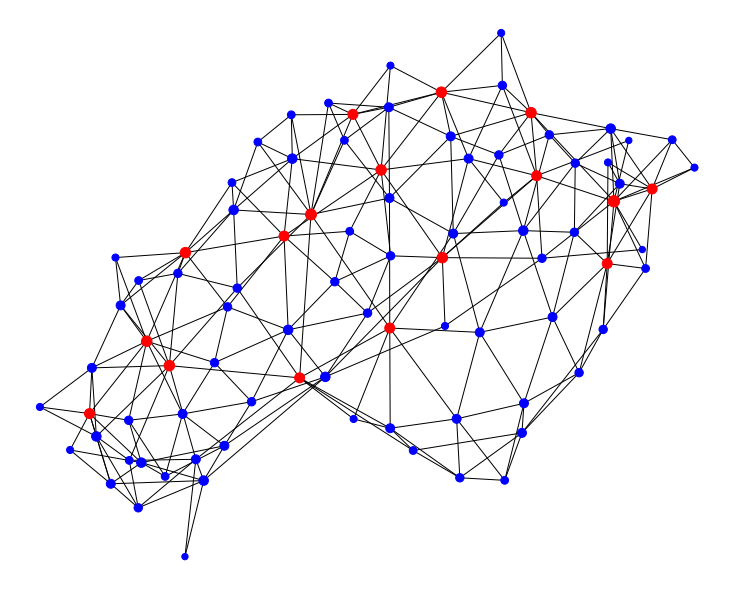

In [14]:
plt.figure(figsize=(10,8))
for graph in os.listdir(path_1)[:1]:
    G = p.load(open(path_1 + graphs[0], "rb" ))
    new_G = remove_dummy_nodes(G)
    d = dict(nx.degree(new_G))
    
    nx.draw(new_G, nodelist=d.keys(), node_size=[v * 10 for v in d.values()],
            node_color = ['blue' if v < 10 else 'red' for v in d.values()])
plt.show()

In [9]:
# plt.figure(figsize=(10,8))
# for graph in os.listdir(path_1):
#     G = p.load(open(path_1 + graph, "rb" )) #read the graphs
#     new_G = remove_dummy_nodes(G)
#     degree_list = list(dict(nx.degree(new_G)).values())
#     plt.hist(degree_list, bins = 20)

In [10]:
# for arr in all_geo_arr:
#     sns.distplot(arr, hist = False, kde = True,
#                  kde_kws = {'shade': True, 'linewidth': 3})

# degree distribution real graph

In [15]:
degree_list = []
for graph in os.listdir(path_1):
    G = p.load(open(path_1 + graph, "rb" )) #read the graphs
    new_G = remove_dummy_nodes(G)
    new_G.remove_edges_from(nx.selfloop_edges(new_G)) # remove self loops
    degree_list.append(list(dict(nx.degree(new_G)).values()))

In [16]:
color = generate_random_color_codes(len(degree_list))
fig = ff.create_distplot(degree_list, os.listdir(path_1), show_hist=False, colors=color)

# Add title
fig.update_layout(title_text='Degree density real graph')
fig.show()

# average neighbour degree distribution

In [17]:
def degree_of_neighb(G):
    nb_degree_dict = {}
    for node in G:
        nb_degree = []
        for nb in G.neighbors(node):
            nb_degree.append(G.degree(nb))
        nb_degree_dict[node] = nb_degree
    return nb_degree_dict

In [18]:
all_graph_nb_degree = []
for graph in os.listdir(path_1):
    graph = nx.read_gpickle(path_1+graph)
    graph = remove_dummy_nodes(graph)
    graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
    all_graph_nb_degree.append(degree_of_neighb(graph))

In [19]:
avg_nb_degree_all_graph = []
for degree_dict in all_graph_nb_degree:
    avg_degree = [np.mean(lst) for lst in list(degree_dict.values())]
    avg_nb_degree_all_graph.append(avg_degree)

In [20]:
color = generate_random_color_codes(len(avg_nb_degree_all_graph))
fig = ff.create_distplot(avg_nb_degree_all_graph, os.listdir(path_1), show_hist=False,bin_size=.2, colors=color)

# Add title
fig.update_layout(title_text='Average neigbour degree for real graphs')
fig.show()

# Average Neighbour Geo distance

In [21]:
# neighbours geo distance

def geo_dist_of_neighb(G):
    nb_dist_dict = {}
    for node in G:
        nb_geo_dist = []
        for nb in G.neighbors(node):
            nb_geo_dist.append(G.get_edge_data(node,nb)['geodesic_distance'])
        nb_dist_dict[node] = nb_geo_dist
    return nb_dist_dict

In [22]:
all_graph_nb_distance = []
for graph in os.listdir(path_1):
    graph = nx.read_gpickle(path_1+graph)
    graph = remove_dummy_nodes(graph)
    graph.remove_edges_from(nx.selfloop_edges(graph)) # remove self loops
    all_graph_nb_distance.append(geo_dist_of_neighb(graph))

In [23]:
avg_nb_dist_all_graph = []
for dist_dict in all_graph_nb_distance:
    avg_dist = [np.mean(lst) for lst in list(dist_dict.values())]
    avg_nb_dist_all_graph.append(avg_dist)

In [24]:
color = generate_random_color_codes(len(avg_nb_dist_all_graph))
fig = ff.create_distplot(avg_nb_dist_all_graph, os.listdir(path_1), show_hist=False,bin_size=.2, colors=color)

# Add title
fig.update_layout(title_text='Average neigbour geo distance for real graphs')
fig.show()

# ------------------------------------------

In [81]:
file_template_mesh = './data/template_mesh/lh.OASIS_testGrp_average_inflated.gii'
file_mesh = './data/example_individual_OASIS_0061/rh.white.gii'
file_basins = './data/example_individual_OASIS_0061/alpha0.03_an0_dn20_r1.5_R_area50FilteredTexture.gii'
file_graph = './data/example_individual_OASIS_0061/OAS1_0061_rh_pitgraph.gpickle'

In [82]:
graph = nx.read_gpickle(file_graph)
gp.preprocess_graph(graph)

# TUTO 1 :: plot the graph on corresponding individual cortical mesh
# load the mesh
mesh = sio.load_mesh(file_mesh)
# eventually smooth it a bit
# import trimesh.smoothing as tms
# mesh = tms.filter_laplacian(mesh, iterations=80)
# load the basins texture
tex_basins = sio.load_texture(file_basins)
# plot the mesh with basin texture

In [116]:
vb_sc = gv.visbrain_plot(mesh, tex=tex_basins.darray[2], cmap='tab20c',
                         caption='Visu on individual mesh with basins',
                         cblabel='basins colors')
# process the graph
# 1 remove potential dummy nodes (which are not connected by any edge and have no coordinate)
gp.remove_dummy_nodes(graph)
# 2 compute nodes coordinates in 3D by retrieving the mesh vertex corresponding to each graph node, based on the
# corresponding node attribute
nodes_coords = gp.graph_nodes_to_coords(graph, 'vertex_index', mesh)
# 3 eventually compute a mask for masking some part of the graph

BrainObj(name='gui') created
Creation of a scene
    BrainObj(name='gui') added to the scene
WARNING | Data defined on a dense grid; ignore smoothing.
    Add data to specific vertices.
    Data scaled between (0.000, 3615.225)


In [117]:
mask_slice_coord=15
nodes_mask = nodes_coords[:, 1] > mask_slice_coord
# 4 create the objects for visualization of the graph and add these to the figure
s_obj, c_obj, node_cb_obj = gv.show_graph(graph, nodes_coords, 
                                          node_color_attribute=None, edge_color_attribute=None,
                             nodes_mask=nodes_mask)

SourceObj(name='nodes') created
    34 sources detected
SourceObj(name='nodes') created
    34 sources detected
ConnectObj(name='edges') created
    34 nodes detected
    strength coloring method for connectivity
    158 connectivity links displayed


In [118]:
#vb_sc.add_to_subplot(c_obj)
vb_sc.add_to_subplot(s_obj)

    SourceObj(name='nodes') added to the scene


WARNING | dpi parameter is not active if `print_size` is None. Use for example `print_size=(5, 5)`


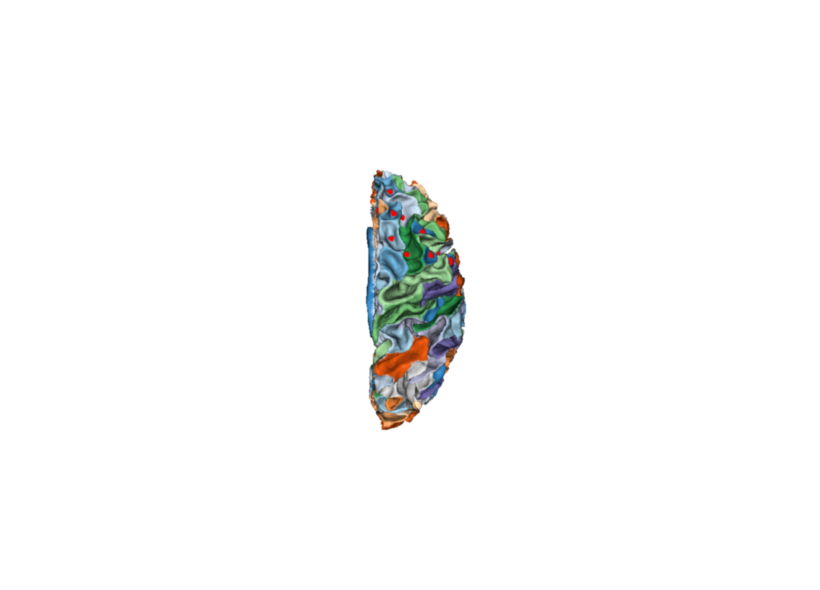

In [119]:
vb_sc.preview()

In [120]:
vb_sc2 = gv.visbrain_plot(mesh, caption='Visu on individual mesh')
s_obj2, c_obj2, node_cb_obj2 = gv.show_graph(graph, nodes_coords, node_color_attribute='depth',
                                          edge_color_attribute='geodesic_distance',
                                          nodes_mask=None)

BrainObj(name='gui') created
Creation of a scene
    BrainObj(name='gui') added to the scene
SourceObj(name='nodes') created
    94 sources detected
    Color nodes using a data vector
Get colorbar properties from SourceObj(name='nodes') object
ColorbarObj(name='nodesCbar') created
ConnectObj(name='edges') created
    94 nodes detected
    strength coloring method for connectivity
    534 connectivity links displayed


In [121]:
vb_sc2.add_to_subplot(c_obj2)
vb_sc2.add_to_subplot(s_obj2)
visb_sc_shape = gv.get_visb_sc_shape(vb_sc2)
vb_sc2.add_to_subplot(node_cb_obj2, row=visb_sc_shape[0] - 1, col=visb_sc_shape[1] + 1, width_max=200)

    ConnectObj(name='edges') added to the scene
    SourceObj(name='nodes') added to the scene
    ColorbarObj(name='nodesCbar') added to the scene


WARNING | dpi parameter is not active if `print_size` is None. Use for example `print_size=(5, 5)`


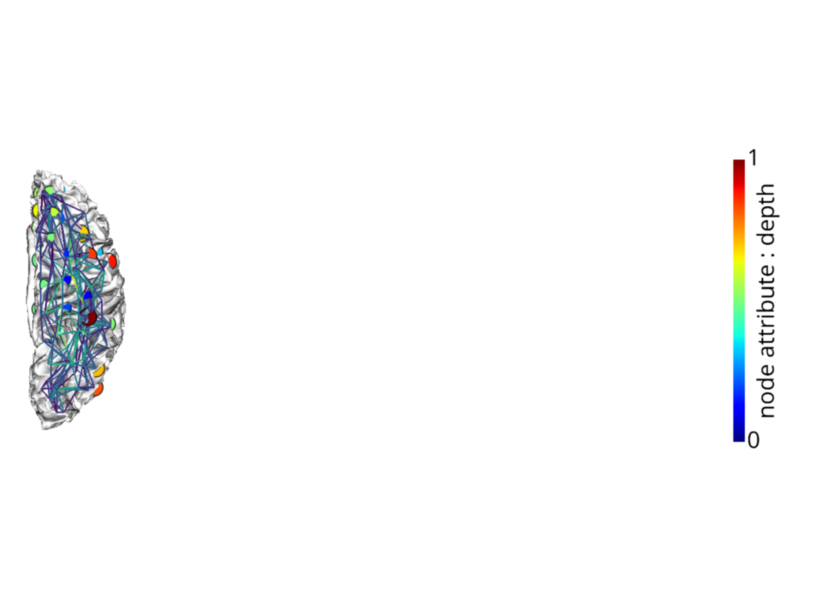

In [122]:
# show the plot on the screen
vb_sc2.preview()

In [25]:
list(graph.nodes.data())

[(0,
  {'vertex_index': 2935,
   'sphere_3dcoords': array([ 21.19021988, -92.98861694, -30.06811714]),
   'sphere_coords': [-1.3467426300048828, 1.8762030601501465],
   'basin_label': 295.0,
   'basin_area': 790.788,
   'depth': -0.61794525,
   'basin_thickness': 2.1981778144836426,
   'ico100_7_vertex_index': 20325,
   'is_dummy': False,
   'label_dbscan': 0}),
 (1,
  {'vertex_index': 3664,
   'sphere_3dcoords': array([-23.73375511, -81.2290802 , -53.27800751]),
   'sphere_coords': [1.2865264415740967, 2.132678508758545],
   'basin_label': 412.0,
   'basin_area': 65.29662,
   'depth': 0.5045013,
   'basin_thickness': 2.3462696075439453,
   'ico100_7_vertex_index': 26032,
   'is_dummy': False,
   'label_dbscan': -1}),
 (2,
  {'vertex_index': 4153,
   'sphere_3dcoords': array([-10.45560169, -93.51826477, -33.83805466]),
   'sphere_coords': [1.459455966949463, 1.9159917831420898],
   'basin_label': 233.0,
   'basin_area': 916.86755,
   'depth': -1.0720392,
   'basin_thickness': 2.4035806